In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#the glob module is used to retrieve files/pathnames matching a specified pattern
from glob import glob
#tqdm library gives a console kind of progress bar for our processes.
from tqdm.notebook import tqdm
#used for image processing tasks such as opening, manipulating, and saving many different image file formats.
from PIL import Image
plt.style.use('ggplot')

In [2]:
import pandas as pd
from glob import glob
img_fns = glob('C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\*')

In [3]:
glob('C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\*')

['C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\1.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\211.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\2112.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\45455.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\545454.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\555.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\56565.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\666.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\8989.jpg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_images\\Presentation_dataset\\download (1).jpeg',
 'C:\\KITSW\\Mini\\input\\textocr-dataset\\train_val_

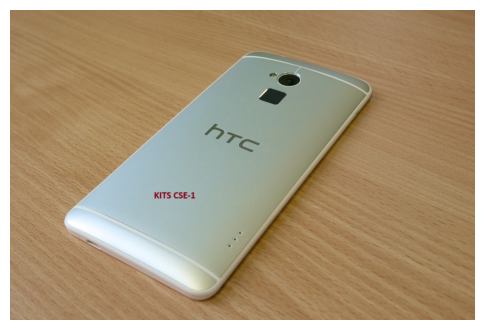

In [4]:
fig, ax = plt.subplots(figsize=(6,6))
ax.imshow(plt.imread(img_fns[0]))
ax.axis('off')
plt.show()

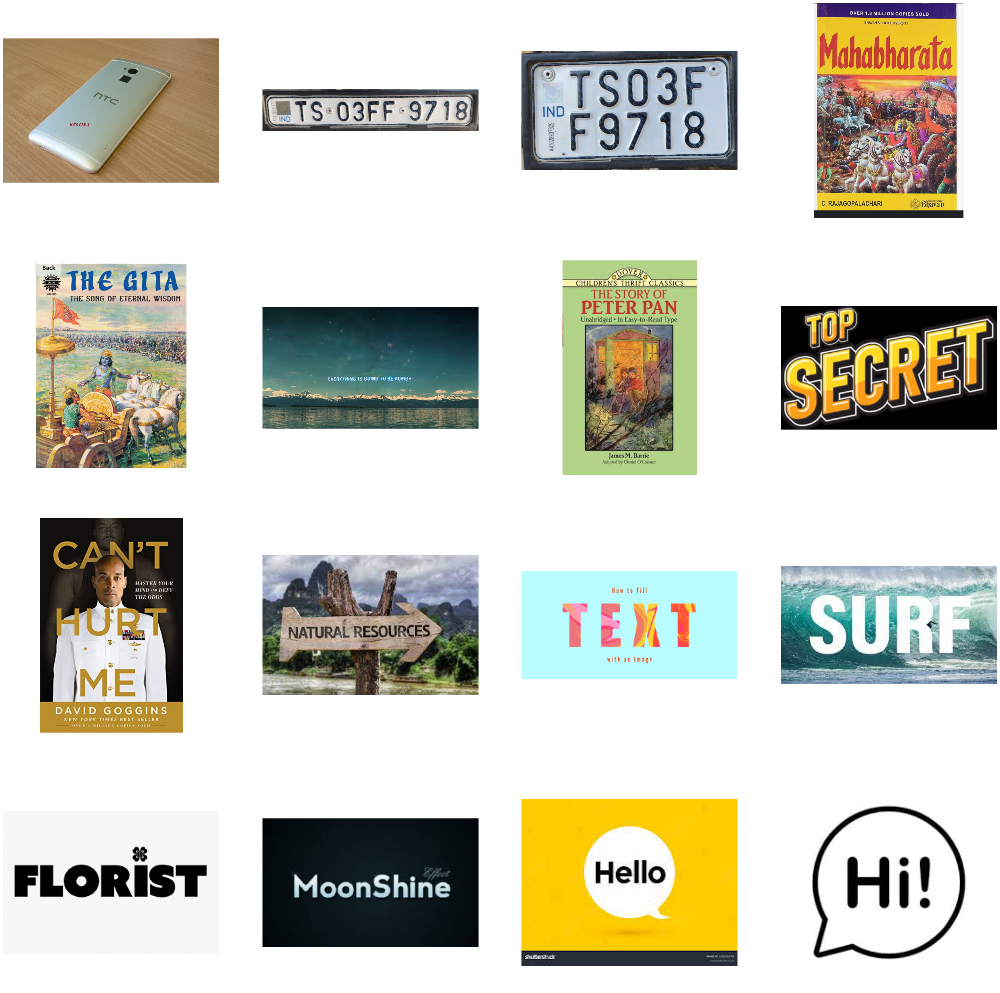

In [5]:
fig, axs = plt.subplots(4, 4, figsize=(40,40))
axs = axs.flatten()
for i in range(16):
    axs[i].imshow(plt.imread(img_fns[i]))
    axs[i].axis('off')
    image_id = img_fns[i].split('/')[-1].rstrip('.jpg')#fetch only the file name(splits at '/')
plt.show()

In [6]:
import easyocr
#The reader object typically provides methods to perform OCR on images, extract text, and obtain information about the detected text such as bounding boxes, confidence scores.
reader = easyocr.Reader(['en'], gpu = True)

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


In [7]:
results = reader.readtext(img_fns[0])

In [8]:
pd.DataFrame(results, columns=['bbox','text','conf'])

,bbox,text,conf
0,"[[314, 396], [412, 396], [412, 420], [314, 420]]",KITS CSE-1,0.842747
1,"[[437.2989525145956, 234.04109637406273], [562...",htc,0.352651


In [9]:
import keras_ocr

pipeline = keras_ocr.pipeline.Pipeline()

Looking for C:\Users\pamra\.keras-ocr\craft_mlt_25k.h5
Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.BILINEAR...)` instead.
Looking for C:\Users\pamra\.keras-ocr\crnn_kurapan.h5


In [10]:
results = pipeline.recognize([img_fns[5]])

1/1 [==============================] - 7s 7s/step


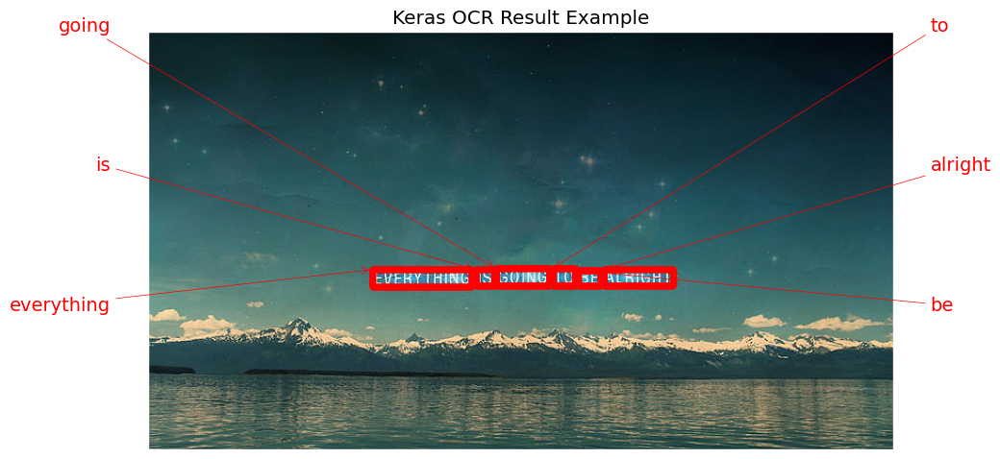

In [11]:
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_fns[5]), results[0], ax=ax)
ax.set_title('Keras OCR Result Example')
plt.show()

In [12]:
# easyocr
reader = easyocr.Reader(['en'], gpu = True)

dfs = []
for img in tqdm(img_fns[:]):
    result = reader.readtext(img)
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['bbox','text','conf'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
easyocr_df = pd.concat(dfs)

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


  0%|          | 0/21 [00:00<?, ?it/s]

In [13]:
# keras_ocr
pipeline = keras_ocr.pipeline.Pipeline()

dfs = []
for img in tqdm(img_fns[:]):
    results = pipeline.recognize([img])
    result = results[0]
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['text', 'bbox'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
kerasocr_df = pd.concat(dfs)

Looking for C:\Users\pamra\.keras-ocr\craft_mlt_25k.h5
Looking for C:\Users\pamra\.keras-ocr\crnn_kurapan.h5


  0%|          | 0/21 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


In [14]:
def plot_compare(img_fn, easyocr_df, kerasocr_df):
    img_id = img_fn.split('/')[-1].split('.')[0]
    fig, axs = plt.subplots(1, 2, figsize=(30, 30))

    easy_results = easyocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    easy_results = [(x[0], np.array(x[1])) for x in easy_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn), easy_results, ax=axs[0])
    
    axs[0].set_title('easyocr results', fontsize=54)

    keras_results = kerasocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    keras_results = [(x[0], np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn), keras_results, ax=axs[1])
    axs[1].set_title('keras_ocr results', fontsize=54)
    plt.show()

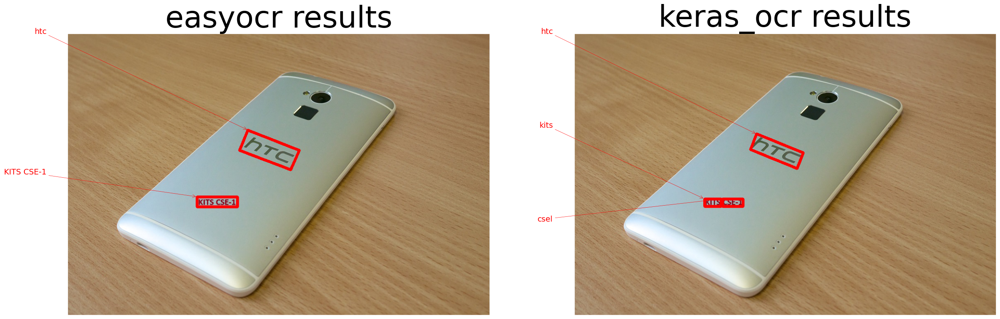

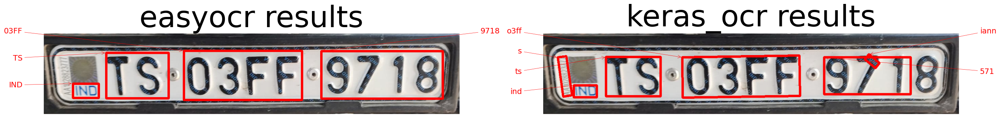

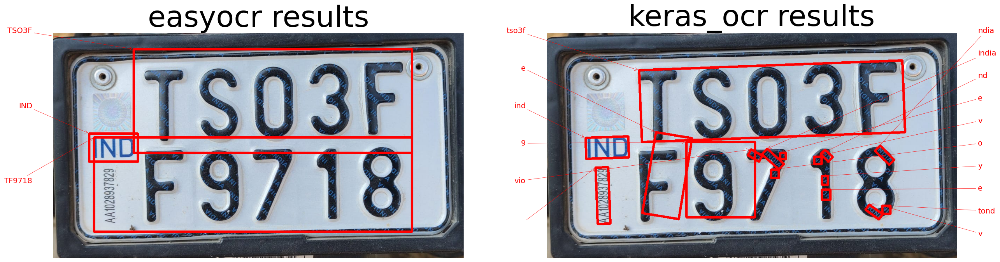

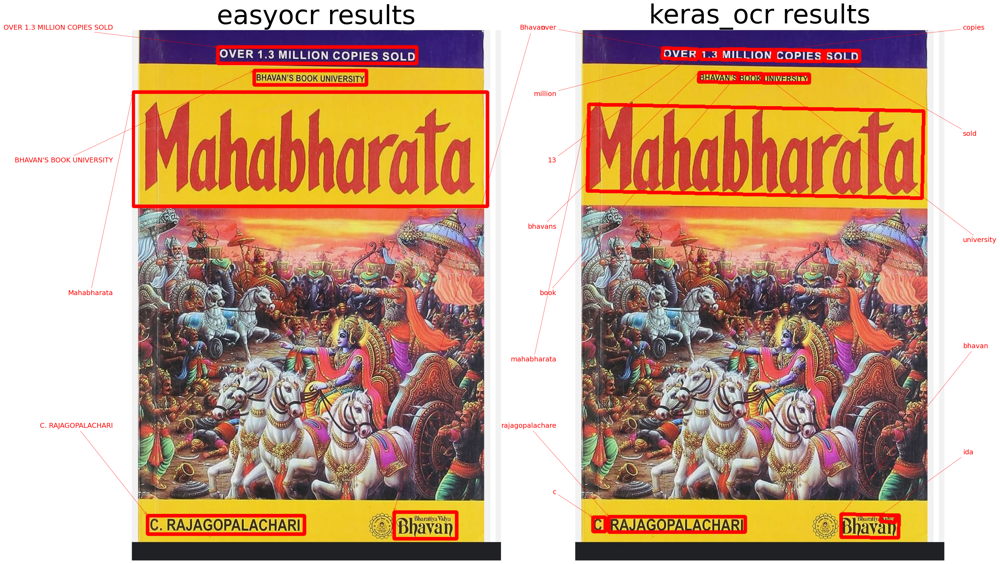

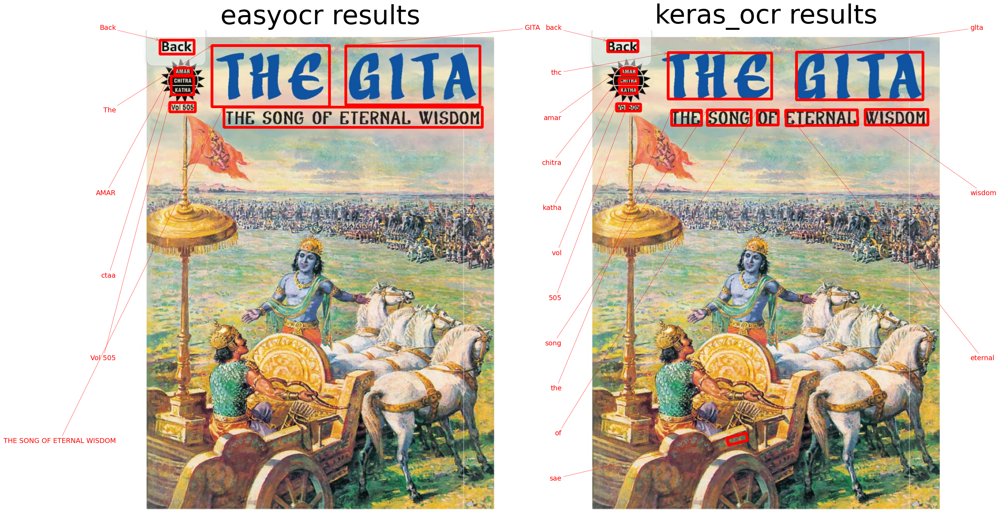

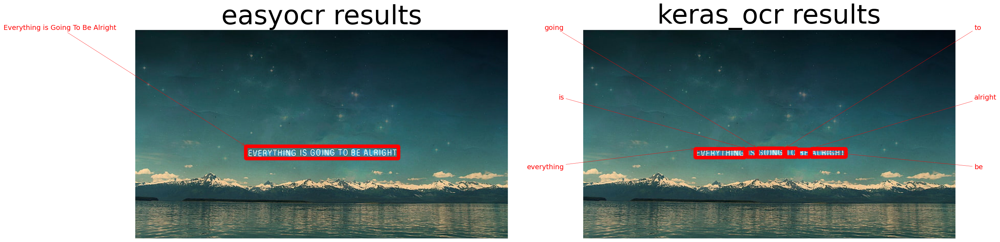

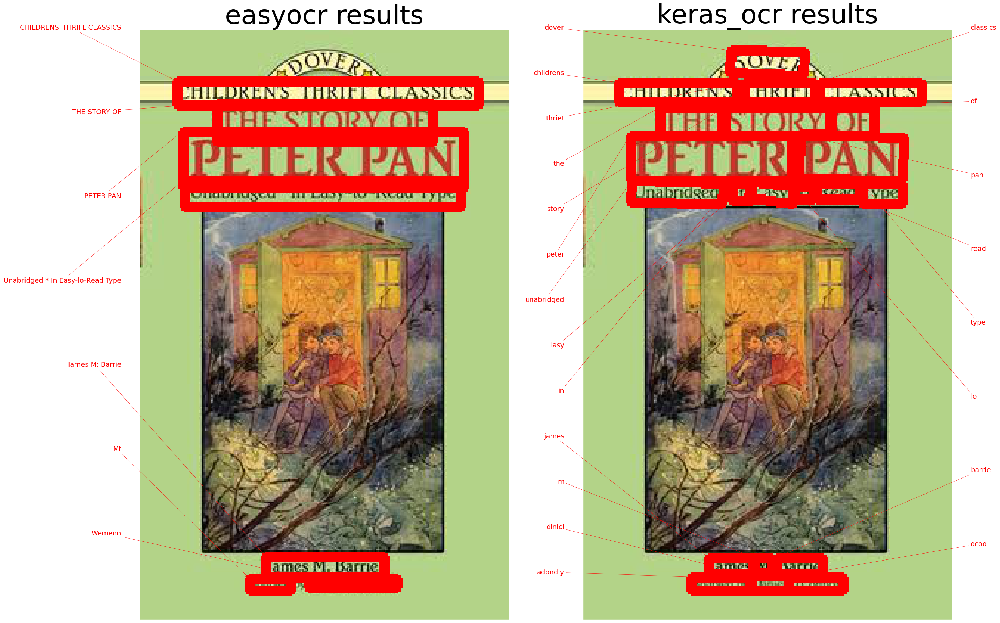

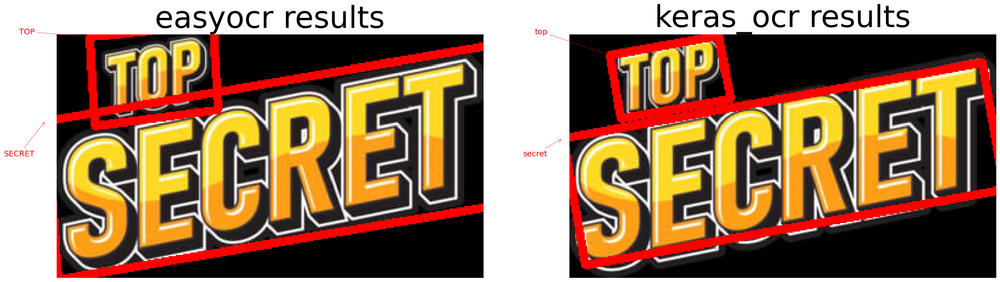

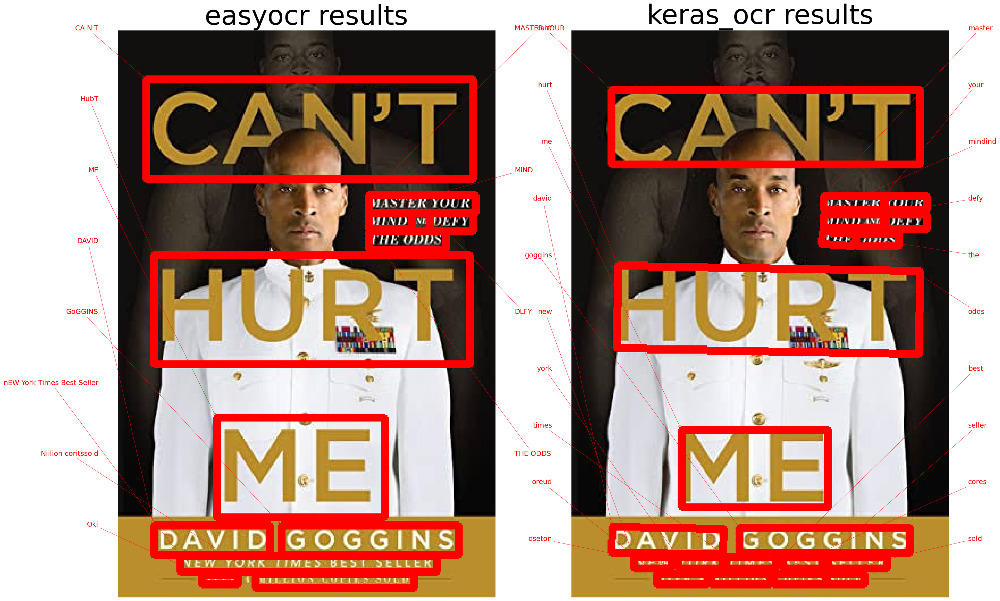

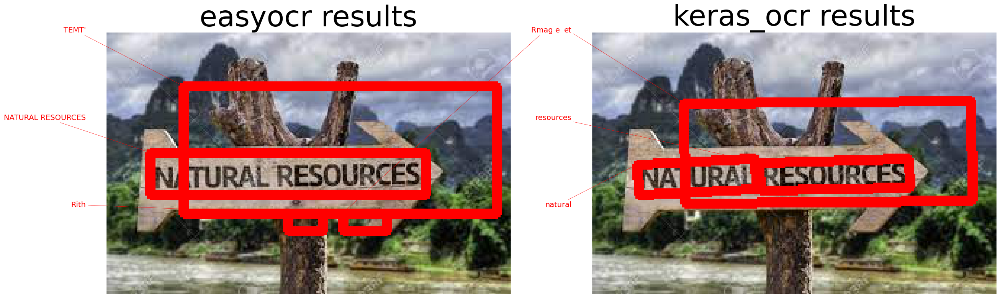

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


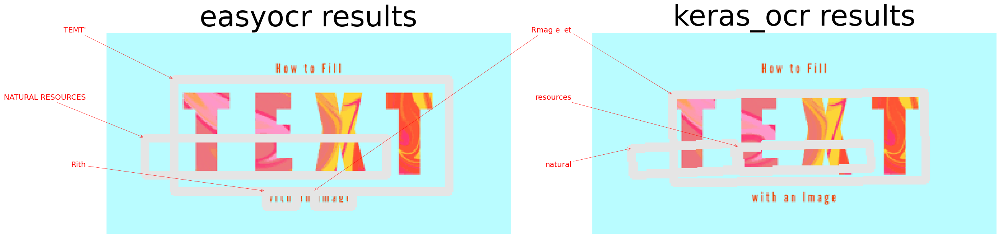

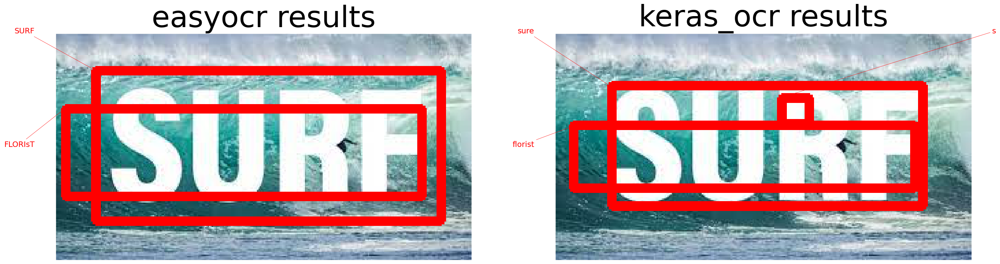

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


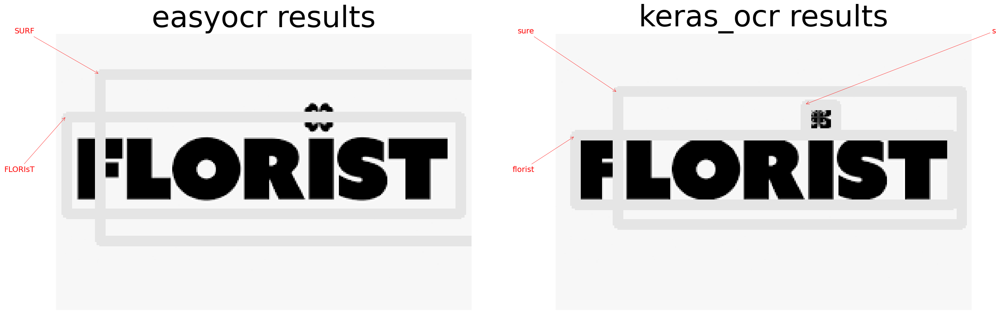

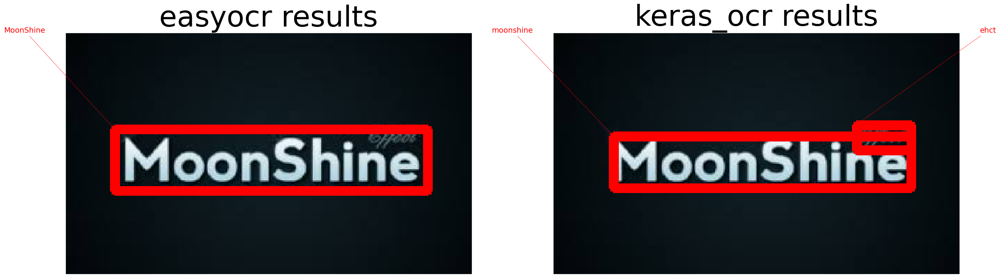

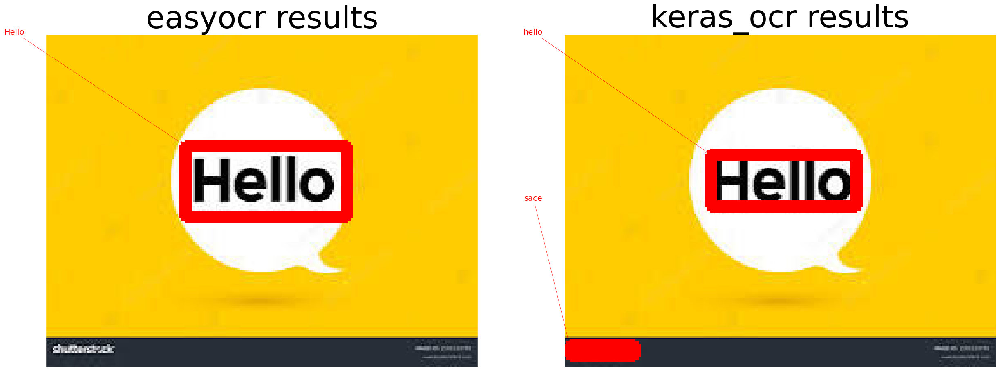

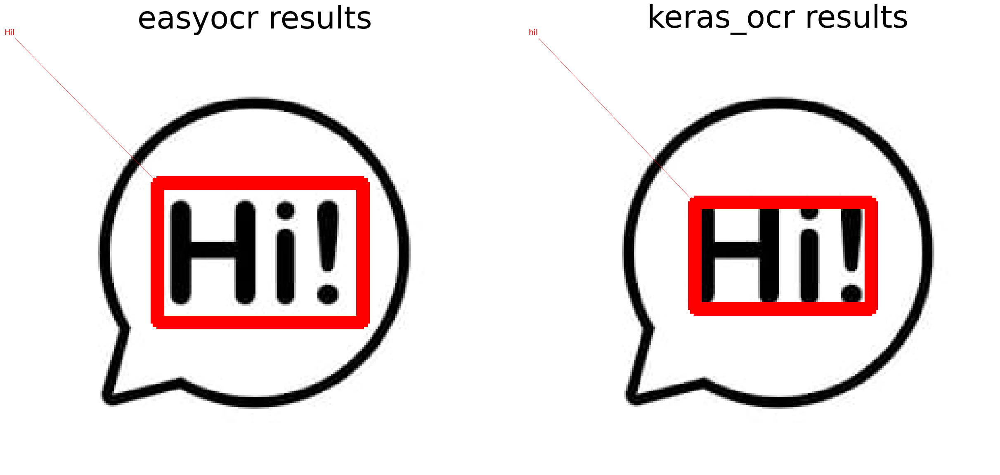

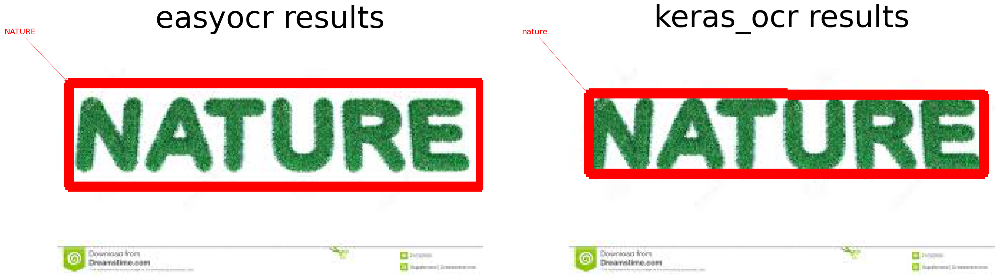

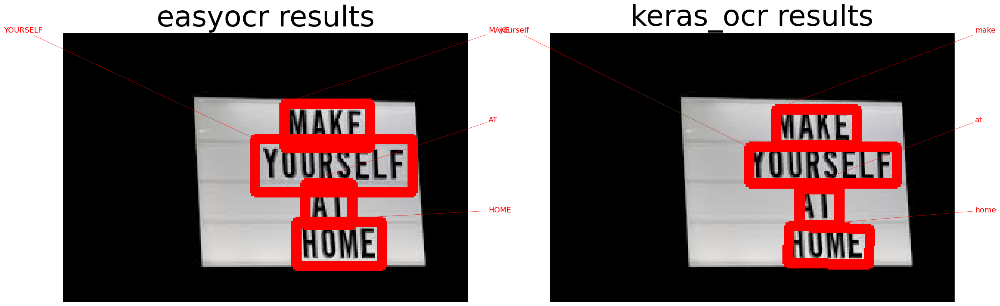

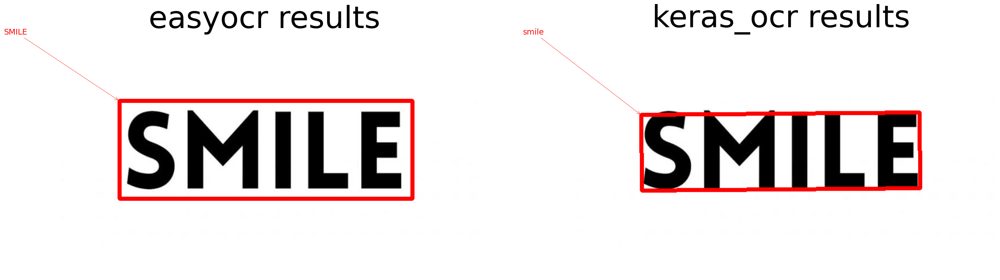

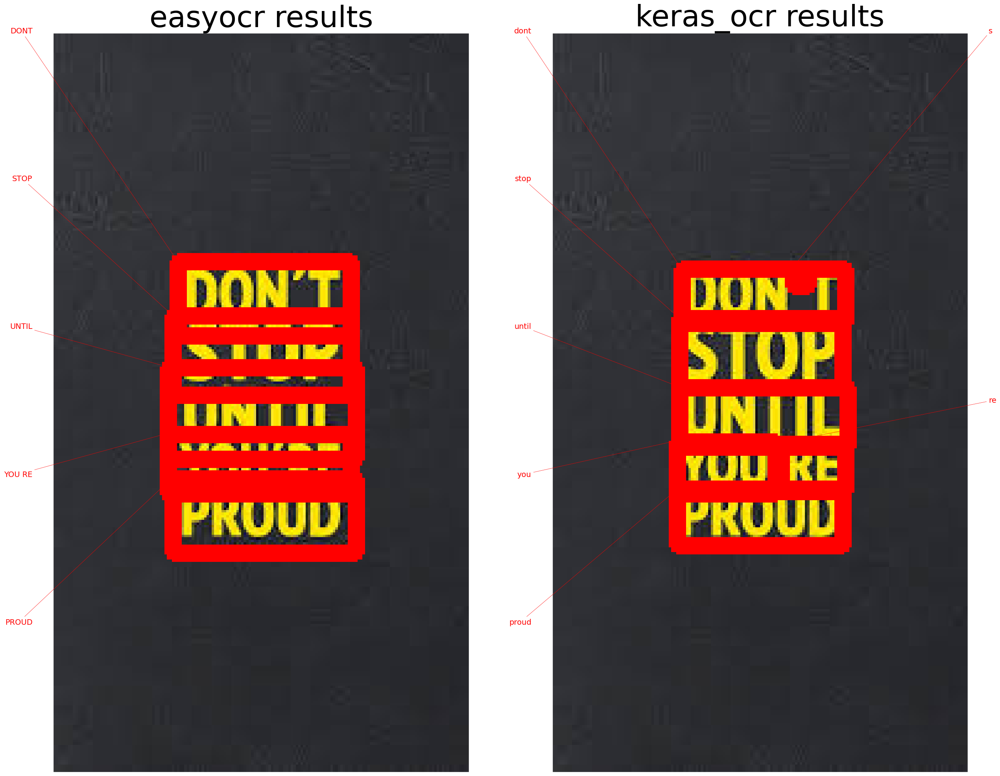

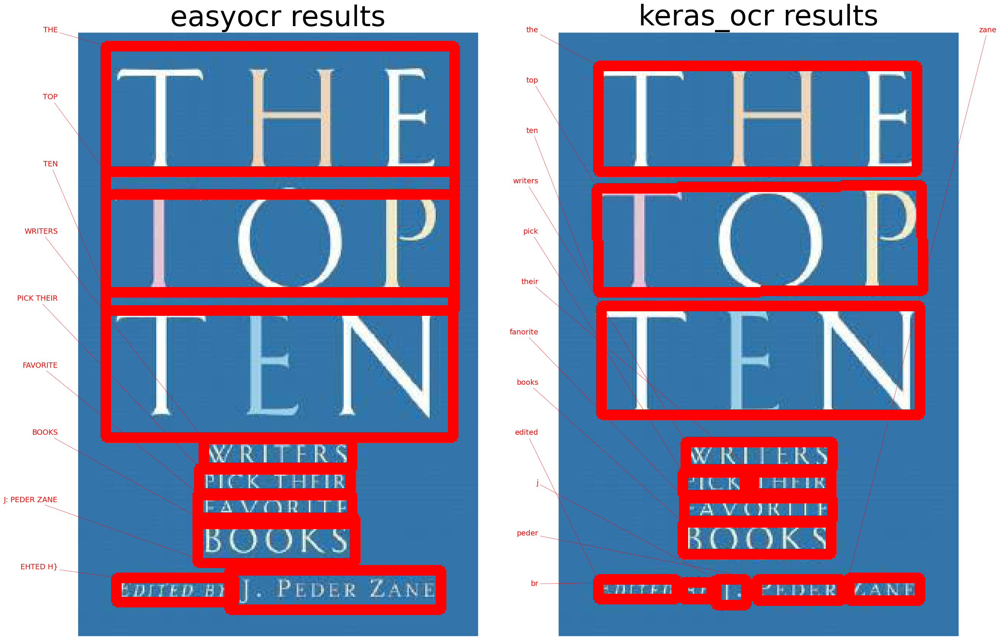

In [15]:
# Loop over results
for img_fn in img_fns[:]:
    plot_compare(img_fn, easyocr_df, kerasocr_df)